In [1]:
from pathlib import Path
import numpy as np
import os, shutil
import matplotlib.pyplot as plt

from PIL import Image

from tqdm.auto import tqdm

import torch
import torchvision
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
from torchvision.transforms import transforms
import torch.optim as optim

from torchvision.models import resnet50, ResNet50_Weights, resnet18, ResNet18_Weights

C:\Users\Caspe\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
transform = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor()
])

In [3]:
class resnet_feature_extractor(torch.nn.Module):
    def __init__(self, input_channels= 4):
        """This class extracts the feature maps from a pretrained Resnet model."""
        super(resnet_feature_extractor, self).__init__()
        self.model = resnet50(weights=ResNet50_Weights.DEFAULT)

        # Average the weights of the first convolution but retain 3 input layers
        weights = self.model.conv1.weight.clone()
        weights_avg = torch.mean(weights, dim=1, keepdim=True)
    
        weights = torch.cat([weights_avg for _ in range(input_channels)], dim=1)
        self.model.conv1.weight = torch.nn.Parameter(weights)
        self.model.conv1.in_channels = input_channels
        
        self.model.eval()
        for param in self.model.parameters():
            param.requires_grad = False

        

        # Hook to extract feature maps
        def hook(module, input, output) -> None:
            """This hook saves the extracted feature map on self.featured."""
            self.features.append(output)

        self.model.layer2[-1].register_forward_hook(hook)            
        self.model.layer3[-1].register_forward_hook(hook) 

    def forward(self, input):

        self.features = []
        with torch.no_grad():
            _ = self.model(input)

        self.avg = torch.nn.AvgPool2d(3, stride=1)
        fmap_size = self.features[0].shape[-2]         # Feature map sizes h, w
        self.resize = torch.nn.AdaptiveAvgPool2d(fmap_size)

        resized_maps = [self.resize(self.avg(fmap)) for fmap in self.features]
        patch = torch.cat(resized_maps, 1)            # Merge the resized feature maps
        patch = patch.reshape(patch.shape[1], -1).T   # Craete a column tensor

        return patch

In [4]:
from src.Dataloader import Dataloader

dataset_path = 'Datasets/Dataset004'
# dataset_path = 'Datasets/IRL_4_channel_dataset'
dataset = Dataloader(dataset_path)
train_loader, val_loader, test_loader = dataset.load_train_vali_test_dataloaders_with_n_images(n_images=3, trainSplit=0.8, BS=1)
# test_loader = dataset.load_test_dataloader(4,1,"/Test_Small_defects")        
image = train_loader.dataset[0]
print(type(image))
image = image.unsqueeze(0).cuda()
# image = transform(image).unsqueeze(0).cuda()

backbone = resnet_feature_extractor(input_channels=3).cuda()
feature = backbone(image)

# print(backbone.features[0].shape)
# print(backbone.features[1].shape)

print(feature.shape)

# plt.imshow(image[0].permute(1,2,0))

<class 'torch.Tensor'>
torch.Size([784, 1536])


In [5]:
memory_bank =[]


for image in tqdm(train_loader.dataset):

    with torch.no_grad():
        data = image.unsqueeze(0).cuda()
        features = backbone(data)
        memory_bank.append(features.cpu().detach())

memory_bank = torch.cat(memory_bank,dim=0).cuda()

100%|██████████| 160/160 [00:01<00:00, 85.00it/s]


In [6]:
y_score=[]

for image in tqdm(train_loader.dataset):
    data = image.unsqueeze(0).cuda()
    with torch.no_grad():
        features = backbone(data)
    distances = torch.cdist(features, memory_bank, p=2.0)
    dist_score, dist_score_idxs = torch.min(distances, dim=1) 
    s_star = torch.max(dist_score)
    segm_map = dist_score.view(1, 1, 28, 28) 

    y_score.append(s_star.cpu().numpy())

100%|██████████| 160/160 [00:15<00:00, 10.64it/s]


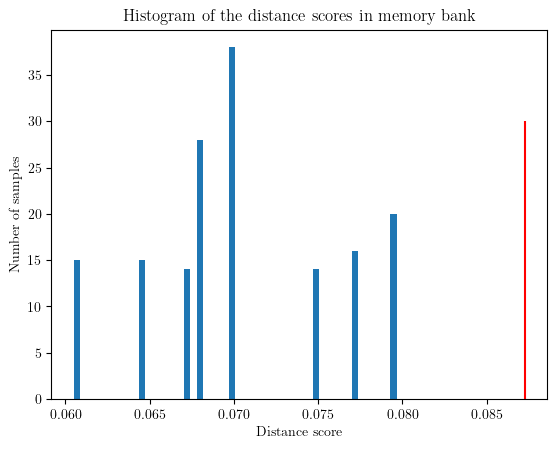

In [7]:
import matplotlib as mpl
# Enable LaTeX rendering
mpl.rcParams['text.usetex'] = True
mpl.rcParams['font.family'] = 'serif'  # LaTeX default font is Computer Modern (serif)
best_threshold = np.mean(y_score) + 3 * np.std(y_score)

plt.hist(y_score,bins=50)
plt.vlines(x=best_threshold,ymin=0,ymax=30,color='r')
plt.title('Histogram of the distance scores in memory bank')
plt.xlabel('Distance score')
plt.ylabel('Number of samples')
plt.show()

In [8]:
y_score = []
y_true=[]


# with torch.no_grad():
#     for inputs, labels in test_loader:
#         inputs = inputs.cuda()
#         outputs = model(inputs)
#         mse = criterion(outputs, inputs).item()

#         y_true.extend(labels.numpy())
#         y_pred.extend([1 if mse > threshold else 0] * len(labels))


for image, label in test_loader:
    with torch.no_grad():
        test_image = image.cuda()
        features = backbone(test_image)

    distances = torch.cdist(features, memory_bank, p=2.0)
    dist_score, dist_score_idxs = torch.min(distances, dim=1) 
    s_star = torch.max(dist_score)
    segm_map = dist_score.view(1, 1, 28, 28) 

    y_score.append(s_star.cpu().numpy())
    y_true.append(label)

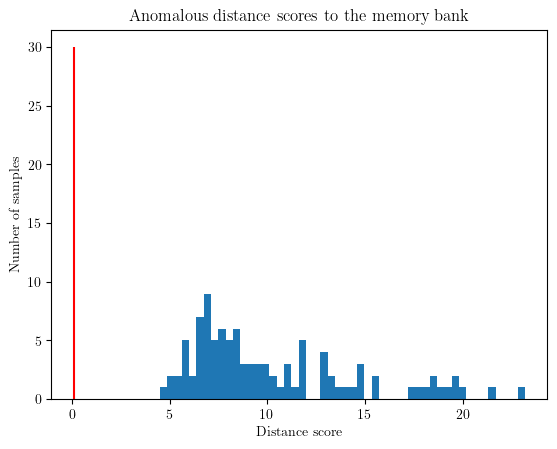

In [9]:
# plotting the y_score values which do not belong to 'good' class

y_score_nok = [score  for score,true in zip(y_score,y_true) if true==1]
plt.hist(y_score_nok,bins=50)
plt.vlines(x=best_threshold,ymin=0,ymax=30,color='r')
plt.title('Anomalous distance scores to the memory bank')
plt.xlabel('Distance score')
plt.ylabel('Number of samples')
plt.show()

torch.Size([3, 224, 224])


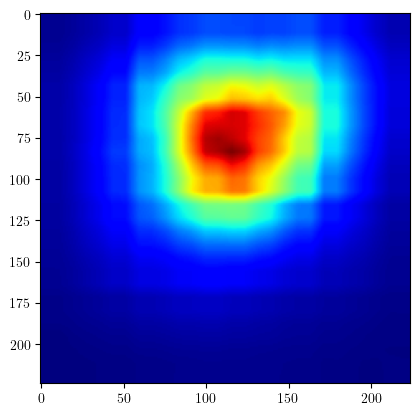

In [10]:
test_image, _ = test_loader.dataset[0]
print(test_image.shape)
features = backbone(test_image.unsqueeze(0).cuda())

distances = torch.cdist(features, memory_bank, p=2.0)
dist_score, dist_score_idxs = torch.min(distances, dim=1) 
s_star = torch.max(dist_score)
segm_map = dist_score.view(1, 1, 28, 28)

segm_map = torch.nn.functional.interpolate(     # Upscale by bi-linaer interpolation to match the original input resolution
                segm_map,
                size=(224, 224),
                mode='bilinear'
            )

plt.imshow(segm_map.cpu().squeeze(), cmap='jet')

Accuracy: 1.0
AUC-ROC Score: 1.0


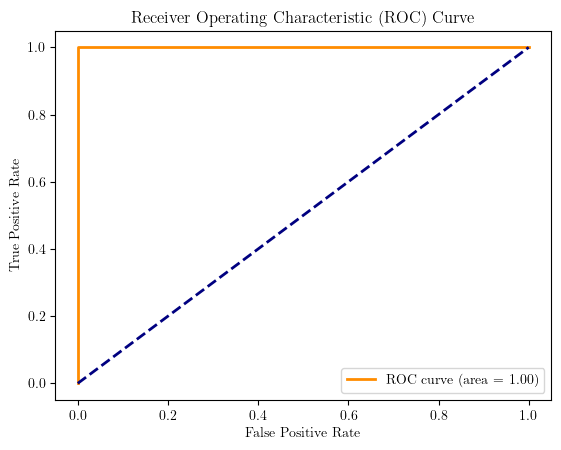

best_threshold = 4.491541862487793


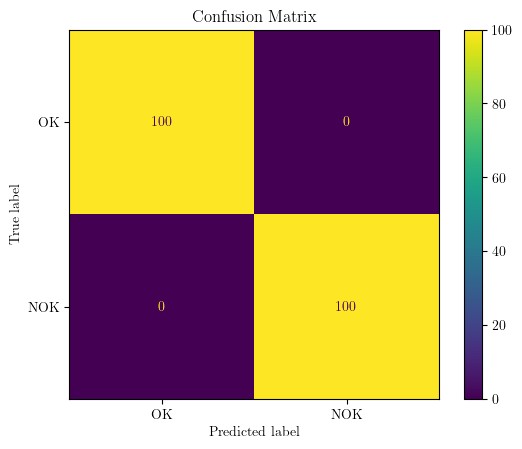

In [11]:
from sklearn.metrics import roc_auc_score, roc_curve, confusion_matrix, ConfusionMatrixDisplay, f1_score, accuracy_score

# Accuracy score
accuracy = accuracy_score(y_true, np.array(y_score) >= best_threshold)
print("Accuracy:", accuracy)

# Calculate AUC-ROC score
auc_roc_score = roc_auc_score(y_true, y_score)
print("AUC-ROC Score:", auc_roc_score)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_true, y_score)
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % auc_roc_score)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.show()

f1_scores = [f1_score(y_true, y_score >= threshold) for threshold in thresholds]

# Select the best threshold based on F1 score
best_threshold = thresholds[np.argmax(f1_scores)]

print(f'best_threshold = {best_threshold}')

# Generate confusion matrix
cm = confusion_matrix(y_true, (y_score >= best_threshold).astype(int))
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=['OK','NOK'])
disp.plot()
plt.title('Confusion Matrix')
plt.show()

In [12]:
# Find the index of a false positive: predicted NOK (1), but true label is OK (0)
false_positives = [i for i, (score, true) in enumerate(zip(y_score, y_true)) if (score >= best_threshold) and (true == 0)]

if false_positives:
    idx = false_positives[0]
    print(f"False positive found at index: {idx}")
    # Retrieve the corresponding image from the test set
    fp_image, fp_label = test_loader.dataset[idx]
    output = backbone(fp_image.unsqueeze(0).cuda())
    distances = torch.cdist(output, memory_bank, p=2.0)
    print(f"Distances shape: {distances.shape}")
    dist_score, dist_score_idxs = torch.min(distances, dim=1)

    s_star = torch.max(dist_score)
    print(f"Distances: {s_star}")
    segm_map = dist_score.view(1, 1, 28, 28)
    segm_map = torch.nn.functional.interpolate(
        segm_map,
        size=(224, 224),
        mode='bilinear'
    )
    ax,fig = plt.subplots(1, 2, figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(fp_image[0].cpu().numpy(), cmap='gray')
    plt.title(f'False Positive')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(segm_map.cpu().squeeze(), cmap='jet')
    plt.title(f'Segmentation Map')

    plt.axis('off')
    plt.show()
else:
    print("No false positives found.")

No false positives found.


In [13]:
# list = [0.9491, 0.966, 0.966, 0.983]
# x = [1, 2, 3, 4]
# plt.plot(x, list, marker='o')
# plt.xticks(x, ['1', '2', '3', '4'])
# plt.xlabel('Number of input images')
# plt.ylabel('Accuracy')
# plt.title('Accuracy vs # images for Patch Core')
# plt.ylim(0.5, 1)


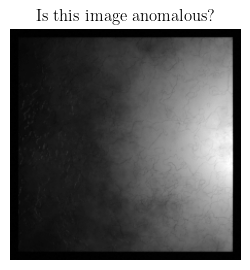

Input (1=anomaly, 0=normal): 

KeyboardInterrupt: 

In [14]:
import random
import time
from IPython.display import clear_output, display
from matplotlib import pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import sys, select

# Prepare shuffled indices for test set
test_indices = list(range(len(test_loader.dataset)))
random.shuffle(test_indices)

human_preds = []
human_truths = []

print("Press 1 for anomaly (NOK), 0 for normal (OK). You have 5 seconds per image.")

for idx in test_indices:
    img, label = test_loader.dataset[idx]
    plt.figure(figsize=(3,3))
    # If image has more than 1 channel, show first channel as grayscale
    if img.ndim == 3 and img.shape[0] > 1:
        plt.imshow(img[0].cpu().numpy(), cmap='gray')
    else:
        plt.imshow(img.cpu().numpy(), cmap='gray')
    plt.axis('off')
    plt.title("Is this image anomalous?")
    display(plt.gcf())
    plt.close()
    
    start = time.time()
    pred = None
    print("Input (1=anomaly, 0=normal): ", end="", flush=True)
    while time.time() - start < 5:
        try:
            # Use input() for user response, but timeout after 5 seconds
            if sys.stdin in select.select([sys.stdin], [], [], 5 - (time.time() - start))[0]:
                inp = input()
                if inp in ['0', '1']:
                    pred = int(inp)
                    break
        except Exception:
            pass
    if pred is None:
        print("\nNo response, counted as 'normal' (0).")
        pred = 0
    human_preds.append(pred)
    human_truths.append(label if isinstance(label, int) else int(label))
    clear_output(wait=True)

# Confusion matrix
cm = confusion_matrix(human_truths, human_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=['OK', 'NOK'])
disp.plot()
plt.title('Human Operator Confusion Matrix')
plt.show()

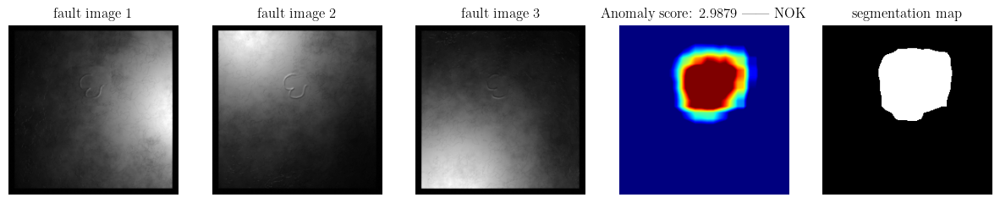

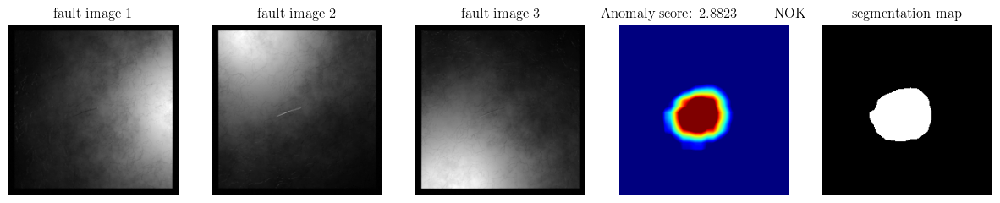

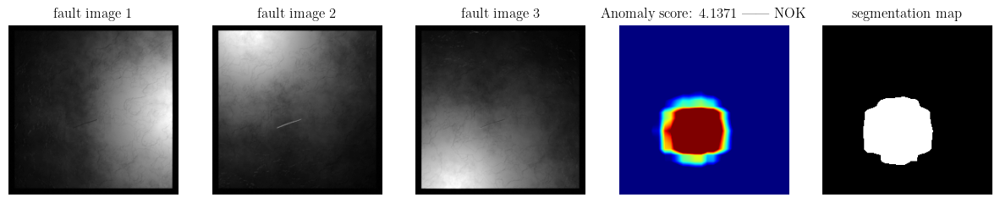

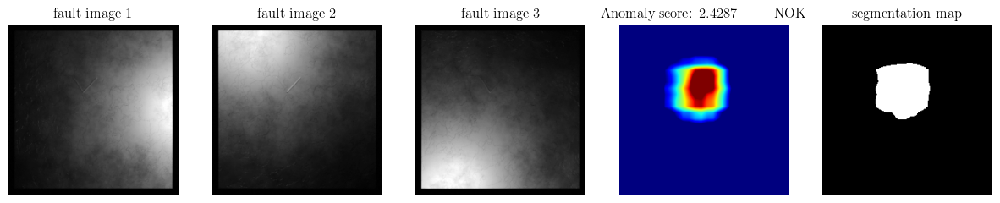

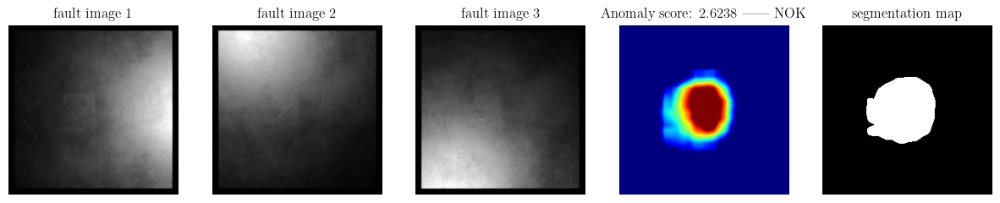

...

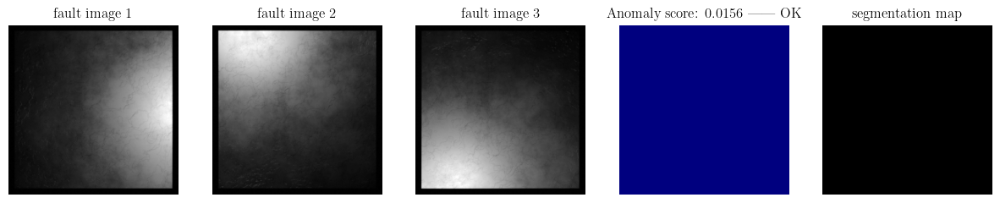

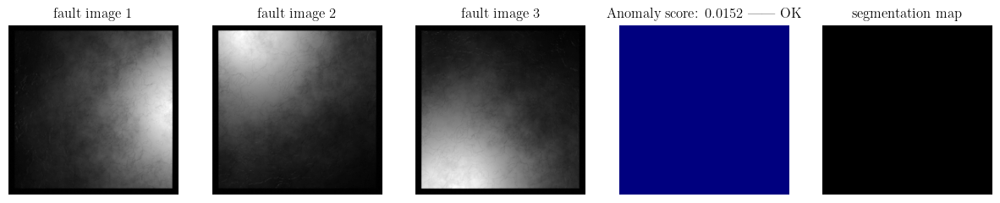

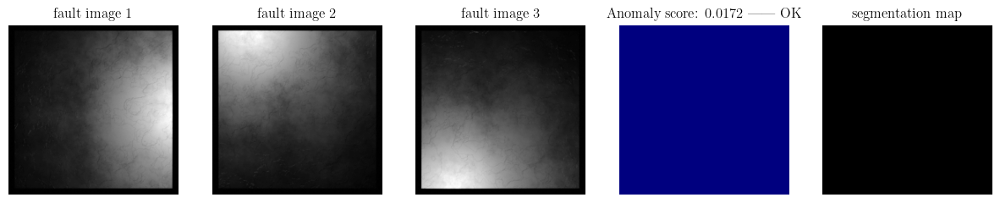

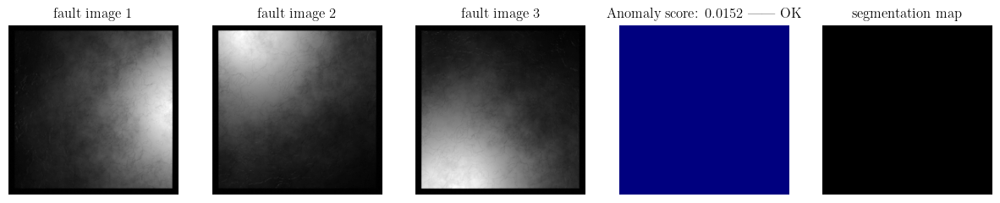

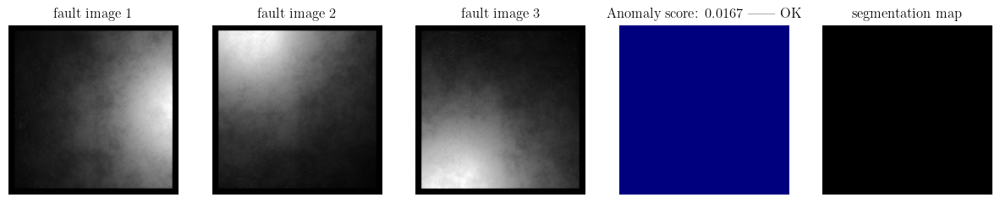

In [ ]:
import cv2, time
from IPython.display import clear_output

backbone.eval()


for image, label in test_loader:
            
    test_image = image.cuda()
    
    with torch.no_grad():
        features = backbone(test_image)
    # Forward pass
    distances = torch.cdist(features, memory_bank, p=2.0)
    dist_score, dist_score_idxs = torch.min(distances, dim=1) 
    s_star = torch.max(dist_score)
    segm_map = dist_score.view(1, 1, 28, 28) 
    segm_map = torch.nn.functional.interpolate(     # Upscale by bi-linaer interpolation to match the original input resolution
                segm_map,
                size=(224, 224),
                mode='bilinear'
            ).cpu().squeeze().numpy()
    
    y_score_image = s_star.cpu().numpy()
    
    y_pred_image = 1*(y_score_image >= best_threshold)
    class_label = ['OK','NOK']


    plt.figure(figsize=(15,5))

    plt.subplot(1,5,1)
    # plt.imshow(test_image.squeeze().permute(1,2,0).cpu().numpy())
    plt.imshow(test_image.squeeze()[0].cpu().numpy(), cmap='gray')
    plt.title(f'fault image 1')
    plt.axis('off')

    plt.subplot(1,5,2)
    plt.imshow(test_image.squeeze()[1].cpu().numpy(), cmap='gray')
    plt.title(f'fault image 2')
    plt.axis('off')

    plt.subplot(1,5,3)
    plt.imshow(test_image.squeeze()[2].cpu().numpy(), cmap='gray')
    plt.title(f'fault image 3')
    plt.axis('off')

    plt.subplot(1,5,4)
    heat_map = segm_map
    plt.imshow(heat_map, cmap='jet',vmin=best_threshold, vmax=best_threshold*2) 
    plt.title(f'Anomaly score: {y_score_image / best_threshold:0.4f} || {class_label[y_pred_image]}')
    plt.axis('off')

    plt.subplot(1,5,5)
    plt.imshow((heat_map > best_threshold*1.25), cmap='gray')
    plt.title(f'segmentation map')
    plt.axis('off')
    plt.show()

    time.sleep(0.05)
    # input()
    # clear_output(wait=True)